In [ ]:
# remove warning throughout the notebook
import warnings
warnings.filterwarnings('ignore')

# packages for dataframe and data
import pandas as pd
import numpy as np

# packages for visualizations / eda
import matplotlib.pyplot as plt
import seaborn as sns
import cufflinks as cf
import plotly
import plotly.express as px
%matplotlib inline
from plotly import __version__
from plotly.offline import download_plotlyjs,init_notebook_mode, plot,iplot
print(__version__) # requires version >= 1.9.0

# packages required for preprocessing
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import LabelEncoder
import glob
import os
from preprocessing.memory import MemoryUtil
from preprocessing.nv import NVUtil
from preprocessing.outlier import OutlierUtil

# packages for Model building
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity='all'

### Reading datasets into Python environment

In [7]:
files = glob.glob(r"D:\sanooj\datascience\data\home-credit-default-risk\*.csv")
files

['D:\\sanooj\\datascience\\data\\home-credit-default-risk\\application_test.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\application_train.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\bureau.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\bureau_balance.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\credit_card_balance.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\HomeCredit_columns_description.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\installments_payments.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\POS_CASH_balance.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\previous_application.csv',
 'D:\\sanooj\\datascience\\data\\home-credit-default-risk\\sample_submission.csv']

In [15]:
application_test = pd.read_csv(files[0])
application_train = pd.read_csv(files[1])
bureau = pd.read_csv(files[2])
bureau_balance = pd.read_csv(files[3])
credit_card_balance = pd.read_csv(files[4])
installments_payments = pd.read_csv(files[6])
POS_CASH_balance = pd.read_csv(files[7])
previous_application = pd.read_csv(files[8])

In [17]:
print(application_test.shape)
print(application_train.shape)
print(bureau.shape)
print(bureau_balance.shape)
print(credit_card_balance.shape)
print(installments_payments.shape)
print(POS_CASH_balance.shape)
print(previous_application.shape)

(48744, 121)
(307511, 122)
(1716428, 17)
(27299925, 3)
(3840312, 23)
(13605401, 8)
(10001358, 8)
(1670214, 37)


### Exploratory Data Analysis

In [ ]:
application_train

(array([1.25018e+05, 1.12767e+05, 4.46440e+04, 1.87860e+04, 4.85000e+03,
        1.03000e+03, 3.73000e+02, 2.30000e+01, 8.00000e+00, 1.20000e+01]),
 array([  45000.,  445500.,  846000., 1246500., 1647000., 2047500.,
        2448000., 2848500., 3249000., 3649500., 4050000.]),
 <a list of 10 Patch objects>)

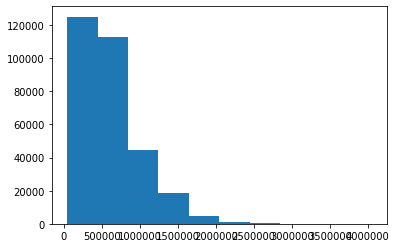

In [21]:
plt.hist(application_train['AMT_CREDIT'])

In [24]:
fig = px.histogram(application_train, x = 'AMT_CREDIT')
fig.show()

- Majority of the customers have taken the loan between 0 - 0.6M
- The distribution is unimode distribution (i.e. in a range of .45M to .46M). around 13199
- Min 50K - Max - 4M is the amount credit opeted for customers
- Majority of the IT professionals might have opted for loan (Hypothesis - 1)
- Majority people opt for an average 0.5M which is ver high to the average American income (Hypothesis - 2)

In [27]:
application_train.sample(100).var().sort_values().tail(35)

EXT_SOURCE_1                   4.459313e-02
FLAG_EMAIL                     5.696970e-02
REG_REGION_NOT_WORK_REGION     6.575758e-02
TARGET                         7.434343e-02
FLAG_DOCUMENT_6                9.888889e-02
REG_CITY_NOT_LIVE_CITY         1.066667e-01
FLAG_WORK_PHONE                1.142424e-01
DEF_60_CNT_SOCIAL_CIRCLE       1.470707e-01
LIVE_CITY_NOT_WORK_CITY        1.616162e-01
FLAG_EMP_PHONE                 1.733333e-01
DEF_30_CNT_SOCIAL_CIRCLE       1.761616e-01
REG_CITY_NOT_WORK_CITY         1.990909e-01
FLAG_DOCUMENT_3                1.990909e-01
FLAG_PHONE                     1.990909e-01
REGION_RATING_CLIENT_W_CITY    2.297980e-01
REGION_RATING_CLIENT           2.359596e-01
AMT_REQ_CREDIT_BUREAU_QRT      4.739935e-01
AMT_REQ_CREDIT_BUREAU_MON      4.839847e-01
CNT_CHILDREN                   4.933333e-01
CNT_FAM_MEMBERS                7.474747e-01
AMT_REQ_CREDIT_BUREAU_YEAR     4.215692e+00
OBS_60_CNT_SOCIAL_CIRCLE       6.909091e+00
OBS_30_CNT_SOCIAL_CIRCLE       7

In [28]:
# AMT_GOODS_PRICE -- For consumer loans it is the price of the goods for which the loan is given
fig = px.histogram(application_train, x = 'AMT_GOODS_PRICE')
fig.show()

In [32]:
class_variables = []
for i in application_train.columns:
    if application_train[i].nunique()  < 3:
        print(i)
        class_variables.append(i)

TARGET
NAME_CONTRACT_TYPE
FLAG_OWN_CAR
FLAG_OWN_REALTY
FLAG_MOBIL
FLAG_EMP_PHONE
FLAG_WORK_PHONE
FLAG_CONT_MOBILE
FLAG_PHONE
FLAG_EMAIL
REG_REGION_NOT_LIVE_REGION
REG_REGION_NOT_WORK_REGION
LIVE_REGION_NOT_WORK_REGION
REG_CITY_NOT_LIVE_CITY
REG_CITY_NOT_WORK_CITY
LIVE_CITY_NOT_WORK_CITY
EMERGENCYSTATE_MODE
FLAG_DOCUMENT_2
FLAG_DOCUMENT_3
FLAG_DOCUMENT_4
FLAG_DOCUMENT_5
FLAG_DOCUMENT_6
FLAG_DOCUMENT_7
FLAG_DOCUMENT_8
FLAG_DOCUMENT_9
FLAG_DOCUMENT_10
FLAG_DOCUMENT_11
FLAG_DOCUMENT_12
FLAG_DOCUMENT_13
FLAG_DOCUMENT_14
FLAG_DOCUMENT_15
FLAG_DOCUMENT_16
FLAG_DOCUMENT_17
FLAG_DOCUMENT_18
FLAG_DOCUMENT_19
FLAG_DOCUMENT_20
FLAG_DOCUMENT_21


In [35]:
#application_train['NAME_CONTRACT_TYPE'].count().iplot(kind='bar')

fig = px.pie(application_train, names = class_variables[1])
fig.show()

- Univariate analysis
    - Continous variables : histograms
    - Class variables : Pie, Count plots

### Let's analyse the class variable - housetype_mode

Normalized information about building where the client lives, What is average (_AVG suffix), modus (_MODE suffix), median (_MEDI suffix) apartment size, common area, living area, age of building, number of elevators, number of entrances, state of the building, number of floor",normalized

In [37]:
fig = px.pie(application_train, names = 'HOUSETYPE_MODE')
fig.show()

<ol>
<li> House types for slightly more than half of the population is not defined </li>
<li> 49% of the population lives in blocks of flats </li>
<li> Less than 1% stays in terraced house or specific housing</li>
<li> More than half of the population who goes for home credit lives in flats (Hypothesis - 1) </li>
<li> People staying in terraced houses might be staying in own house already, so chances of going for second loan is close to zero (Hypothesis -2) </li>
</ol>

### Pre-processing

#### Memory Management

In [41]:
application_train = MemoryUtil.memory_optimize(application_train)
application_test = MemoryUtil.memory_optimize(application_test)

Memory usage before optimization is: 286.23 MB
Memory usage after optimization is: 59.54 MB
Decreased by 79.2%
Memory usage before optimization is: 45.00 MB
Memory usage after optimization is: 9.40 MB
Decreased by 79.1%


#### Null Value Treatment

In [42]:
excluded_columns_train,selected_columns_train,numerical_columns_train,categorical_columns_train,application_train = NVUtil.nv_treatment(application_train,30)


Before NV treatment the stats are as below
SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
                              ...  
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_YEAR    41519
Length: 122, dtype: int64
Before NV treatment the stats are as below
SK_ID_CURR                    0
TARGET                        0
NAME_CONTRACT_TYPE            0
CODE_GENDER                   0
FLAG_OWN_CAR                  0
                             ..
AMT_REQ_CREDIT_BUREAU_DAY     0
AMT_REQ_CREDIT_BUREAU_WEEK    0
AMT_REQ_CREDIT_BUREAU_MON     0
AMT_REQ_CREDIT_BUREAU_QRT     0
AMT_REQ_CREDIT_BUREAU_YEAR    0
Length: 72, dtype: int64


In [43]:
excluded_columns_test,selected_columns_test,numerical_columns_test,categorical_columns_test,application_test = NVUtil.nv_treatment(application_test,30)


Before NV treatment the stats are as below
SK_ID_CURR                       0
NAME_CONTRACT_TYPE               0
CODE_GENDER                      0
FLAG_OWN_CAR                     0
FLAG_OWN_REALTY                  0
                              ... 
AMT_REQ_CREDIT_BUREAU_DAY     6049
AMT_REQ_CREDIT_BUREAU_WEEK    6049
AMT_REQ_CREDIT_BUREAU_MON     6049
AMT_REQ_CREDIT_BUREAU_QRT     6049
AMT_REQ_CREDIT_BUREAU_YEAR    6049
Length: 121, dtype: int64
Before NV treatment the stats are as below
SK_ID_CURR                    0
NAME_CONTRACT_TYPE            0
CODE_GENDER                   0
FLAG_OWN_CAR                  0
FLAG_OWN_REALTY               0
                             ..
AMT_REQ_CREDIT_BUREAU_DAY     0
AMT_REQ_CREDIT_BUREAU_WEEK    0
AMT_REQ_CREDIT_BUREAU_MON     0
AMT_REQ_CREDIT_BUREAU_QRT     0
AMT_REQ_CREDIT_BUREAU_YEAR    0
Length: 71, dtype: int64


#### Outlier Treatment

In [ ]:
### Remove y variable from outlier treatment ### TODO

In [ ]:
application_train = OutlierUtil.iqr_outlier_treatment(application_train,numerical_columns_train)


Before iqr outler treatment the stats are as below
          SK_ID_CURR         TARGET   CNT_CHILDREN  AMT_INCOME_TOTAL  \
count  307511.000000  307511.000000  307511.000000      3.075110e+05   
mean   278180.518577       0.080729       0.417052      1.687391e+05   
std    102790.175348       0.272419       0.722121      2.371759e+05   
min    100002.000000       0.000000       0.000000      2.565000e+04   
25%    189145.500000       0.000000       0.000000      1.125000e+05   
50%    278202.000000       0.000000       0.000000      1.471500e+05   
75%    367142.500000       0.000000       1.000000      2.025000e+05   
max    456255.000000       1.000000      19.000000      1.170000e+08   

         AMT_CREDIT    AMT_ANNUITY  AMT_GOODS_PRICE  \
count  3.075110e+05  307511.000000     3.075110e+05   
mean   5.988308e+05   27110.880859     5.378983e+05   
std    4.024795e+05   14492.979492     3.694427e+05   
min    4.500000e+04    1615.500000     4.050000e+04   
25%    2.700000e+05   16

#### Label Encoding

In [ ]:
def label_encoders(df,cat):
    le = LabelEncoder()
    for i in cat:
        le.fit(df[i])
        x = le.transform(df[i])
        df[i]=x
return df

#### Univariate

In [ ]:
def univairate(base_dataset):
    for i in base_dataset.var().sort_values(ascending=False).head().index:
        sns.boxplot(base_dataset[i])
        plt.show()
    for i in base_dataset.var().sort_values(ascending=False).head().index:
        sns.distplot(base_dataset[i],kde=False)
        plt.show()

#### SMOTE

#### MinMax Scalar

In [ ]:
def min_max_scalar(df):
    from sklearn.preprocessing import MinMaxScaler,StandardScaler
    import pandas as pd
    num=df.mean().index
    for i in num:
        mn=MinMaxScaler()
        mn.fit(pd.DataFrame(df[i]))
        x=mn.transform(pd.DataFrame(df[i]))
        df[i]=x
    return df

#### Standard Scalar

In [ ]:
def standard_scalar(df3):
    from sklearn.preprocessing import StandardScaler    
    mn=StandardScaler()
    for i in df3.columns:
        mn.fit(pd.DataFrame(df3[i]))
        x=mn.transform(pd.DataFrame(df3[i]))
        df3[i]=x
        print(df3.describe())
    return df3